# Processing and Analysis of Magnetic Resonance Spectroscopy Data

## Part 1: Processing and Fitting MRS Data

The first part of this notebook demonstrates the basic principles of processing single voxel magnetic resonance spectroscopy data including preprocessing, linear combination modelling, quantification, and finally an example for statistically analysing cohort data while taking measurement uncertainties into account. 

The first part containing the pre-processing, fitting and quantification is performed using the FSL-MRS toolbox (https://git.fmrib.ox.ac.uk/fsl/fsl_mrs; Clarke WT, Stagg CJ, Jbabdi S. FSL-MRS: An end-to-end spectroscopy analysis package. Magnetic Resonance in Medicine 2021;85:2950–2964 doi: 10.1002/mrm.28630) and is based on the example notebooks from Will Clark, University of Oxford, which can also be found in the FSL repository. 
The used spectroscopy data set is a modified version of the MRS data set acquired in Oxford at a 7T MR scanner, an can also be found in the FSL-MRS repository.

### Loading of data and having a first look

First, we load the data, in order to have a first look at them. 

There are 4 different files: 
1. an MRS scan, which contains of 64 transients (repetitions, averages, dynamics), which were acquired with water suppression "steam_metab_raw"
2. a water reference scan containing 2 transients that were acquired without water suppression but otherwise identical settings as the metabolite scan, which will be used as a reference for coil combination "steam_wref_comb_raw"
3. a water reference scan containing 2 transients, which was obtained without any outer volume suppression or water suppression. Hence, this scan does exhibit different eddy currents than all of the other scans. It will be used for quantification. "steam_wref_quant_raw.nii.gz"
4. an unsuppressed reference scan, which was acquired before the main metabolite scan. It will be used as reference for eddy current correction. "steam_ecc_raw"


In [6]:
import fsl_mrs.utils.mrs_io as mrs_io

# Load the raw metabolite data
supp_data = mrs_io.read_FID('tutorial3_data/steam_metab_raw.nii.gz')
print(f'Loaded water supressed data with shape {supp_data.shape} and dimensions {supp_data.dim_tags}.')

# Load water ref with eddy currents (for coil combination)
ref_data = mrs_io.read_FID('tutorial3_data/steam_wref_comb_raw.nii.gz')
print(f'Loaded unsupressed data with shape {ref_data.shape} and dimensions {ref_data.dim_tags}.')

# Load water ref without eddy currents (for quantification)
quant_data = mrs_io.read_FID('tutorial3_data/steam_wref_quant_raw.nii.gz')
print(f'Loaded unsupressed data with shape {quant_data.shape} and dimensions {quant_data.dim_tags}.')

# Load phasecor scan (for Eddy)
ecc_data = mrs_io.read_FID('tutorial3_data/steam_ecc_raw.nii.gz')
print(f'Loaded unsupressed data with shape {ecc_data.shape} and dimensions {ecc_data.dim_tags}.')

The output displays the shape of the MRS objects. It can be seen that each FID contains 4096 sample points, that a 32-channel receive coil was used for the acquisition, and the number of transients (or dynamics) that were recorded in each scan. Furthermore, two of the object dimensions contain tags: 'DIM_COIL' and 'DIM_DYN', which will be helpful in the following processing.

### Quality Check and Correction for Motion Coruption

In order to do a first quality check of the data, let's have a look at the individual transients. To make sure we see more than noise, it makes sense, to initially combine the different coil signals, using the reference scan ref_data for phase correction of the individual coil signals. 

In [ ]:
from fsl_mrs.utils.preproc import nifti_mrs_proc as proc

# average the reference data, to make sure the reference signal has a good SNR
avg_ref_data = proc.average(ref_data, 'DIM_DYN')

# perform a coil combination to make sure the individual transients do have a good SNR when looking at them
supp_data_test = proc.coilcombine(supp_data, reference=avg_ref_data)

Sometimes a patient doesn't lie still throughout the whole examination, leading to individual transients looking completely different than the other ones. To make sure these motion corrupted transients won't mess with the analysis it is important to find those transients and exclude them. 

# Task: Find out the indices of motion corrupted transients!

(5.5, 0.0)

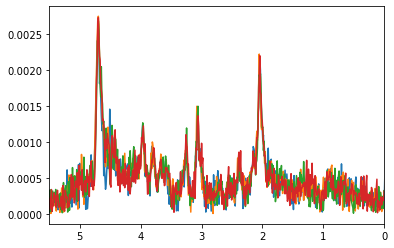

In [12]:
import numpy as np
import matplotlib.pyplot as plt
from fsl_mrs.utils import plotting

# perform a Fast Fourier Transform in order to look at the spectra in freqeuncy domain
plotData = supp_data_test.data.squeeze().astype("complex128")
plotDataFt = np.fft.fftshift(np.fft.fft(plotData,axis=0),axes=0)
# generate a suitable x-Axix for the plot, so we know the signals are in the correct frequency area
dt = supp_data.dwelltime
bw = supp_data.bandwidth
fc = supp_data.spectrometer_frequency
n = plotData.shape[0]
fAxis = np.linspace(-bw/2,bw/2,n)
fAxis = np.linspace(-bw/2,bw/2,n)/fc+4.7

# plot the individual transients by altering the indix of the transient and find the motion corrupted transients
p = plt.plot(fAxis,np.abs(plotDataFt[:,0]))

# set the limits of the plot to the chemical shift range of interest
plt.xlim((5.5,0))

To exclude the motion corupted transients from the MRS object, we can use a toolbox from the spec2nii package in the command line. A new .nii.gz file will be written without the transients in question, which then needs to be loaded again.

# Task: insert the indices of the motion corrupted transients to remove them from the data set

In [40]:
%%bash
# check dimensions of the data set before interaction
mrs_tools info tutorial3_data/steam_metab_raw.nii.gz

# exclude motion corrupted transients from data set
mrs_tools split --file tutorial3_data/steam_metab_raw.nii.gz --output tutorial3_data/split --dim DIM_DYN --indices xx xy

# check dimensions of the data sets after splitting them
mrs_tools info tutorial3_data/split/steam_metab_raw_1.nii.gz
mrs_tools info tutorial3_data/split/steam_metab_raw_2.nii.gz

# load the new data set to proceed with processing
supp_data = mrs_io.read_FID('tutorial3_data/split/steam_metab_raw.nii.gz')
print(f'Loaded water supressed data with shape {supp_data.shape} and dimensions {supp_data.dim_tags}.')


Read file steam_metab_raw.nii.gz (/home/fillme01/_Programme/FSL/data).
NIfTI-MRS version 0.5
Data shape (1, 1, 1, 4096, 32, 64)
Dimension tags: ['DIM_COIL', 'DIM_DYN', None]
Spectrometer Frequency: 297.219948 MHz
Dwelltime (Bandwidth): 8.330E-05s (12005 Hz)
Nucleus: 1H
Field Strength: 6.98 T


Read file steam_metab_raw_1.nii.gz (/home/fillme01/_Programme/FSL/data/split).
NIfTI-MRS version 0.5
Data shape (1, 1, 1, 4096, 32, 62)
Dimension tags: ['DIM_COIL', 'DIM_DYN', None]
Spectrometer Frequency: 297.219948 MHz
Dwelltime (Bandwidth): 8.330E-05s (12005 Hz)
Nucleus: 1H
Field Strength: 6.98 T


Read file steam_metab_raw_1_1.nii.gz (/home/fillme01/_Programme/FSL/data/split).
NIfTI-MRS version 0.5
Data shape (1, 1, 1, 4096, 32, 48)
Dimension tags: ['DIM_COIL', 'DIM_DYN', None]
Spectrometer Frequency: 297.219948 MHz
Dwelltime (Bandwidth): 8.330E-05s (12005 Hz)
Nucleus: 1H
Field Strength: 6.98 T


Read file steam_metab_raw_1_2.nii.gz (/home/fillme01/_Programme/FSL/data/split).
NIfTI-MRS versi

After excluding the motion corupted transients, we can combine the individual transients and check the initial spectral quality:

In [54]:
from fsl_mrs.utils.preproc import nifti_mrs_proc as proc

avg_ref_data = proc.average(ref_data, 'DIM_DYN', figure=True)
avg_metab_data = proc.average(supp_data, 'DIM_DYN', figure=True)

The figures show the individual transients and the averaged spectrum of the individual data set. If one of the transients here still looks very different from all the others, you should go back and check again which transients to exclude.

### Preprocessing

We can now perform a coil combination on the (non-averaged) metabolite data set, as well as on the reference for quantification and eddy current correction, using the reference data set for coil combination (avg_ref_data) as reference:

In [6]:
supp_data = proc.coilcombine(supp_data, reference=avg_ref_data, figure=True)
quant_data = proc.coilcombine(quant_data, reference=avg_ref_data)
ecc_data = proc.coilcombine(ecc_data, reference=avg_ref_data)


As can be seen, the combined data start to appear like a spectrum, however, the major peaks are facing down. Spectral data (as all MRI raw data) are complex data. While in MRS we mostly look at the real part of the complex data, the imaginary part of the data is still there (and contained in all of the MRS objects used throughout FSL-MRS). This means, we can change the phase of the real part (and imaginary part) of the spectral data, without changing the information content. However, the quantification and judgement of data quality is much easier, if as many peaks as possible point in the same direction (usually upwards). Hence, we apply a 180° phase shift to have a reasonable phase for display purposes:

In [7]:
supp_data = proc.apply_fixed_phase(supp_data, 180.0, figure=True)
quant_data = proc.apply_fixed_phase(quant_data, 180.0)
ecc_data = proc.apply_fixed_phase(ecc_data, 180.0)


As minor motion of the subject, as well as other physical effects (e.g. temperature differences) throughout the rather lengthy scan time, may introduce frequency and phase fluctuations between transients, the frequency and phase between individual transients should be corrected to be consistent to allow for optimal averaging later on: 

In [8]:
supp_data_aligned = proc.align(supp_data, 'DIM_DYN', ppmlim=(0, 4.2), figure=True)
# Alignment for water scans
quant_data_aligned = proc.align(quant_data, 'DIM_DYN', ppmlim=(0, 8))

You can see, that the transients, which were aligned to each other, result in peaks with smaller linewidth, which will later on improve the quality of the fitting procedure and the quantification. 

After correcting for phase and frequency fluctuations we can now average the individual transients:

In [9]:
supp_data_aligned = proc.average(supp_data_aligned, 'DIM_DYN', figure=True)
quant_data_aligned = proc.average(quant_data_aligned, 'DIM_DYN')

After averaging the data, we perform an eddy current correction, in order to get rid of non-linear phase shifts throughout the FID, introduced by the gradients used for localization. To do this, the eddy current reference data set "ecc_data" needs to be used for the metabolite scan. However, as the water reference scan "quant_data", which will be used for the quantification later, was acquired with different gradients (especially no outer volume suppression was used), we need to use another reference for this data set, otherwise we will introduce non-linear phase shifts instead of removing it. Luckily, the water signal intensity is large enough, so that the "quant_data" scan can act as its own reference:

In [10]:
supp_data_aligned = proc.ecc(supp_data_aligned, ecc_data, figure=True)
quant_data_aligned = proc.ecc(quant_data_aligned, quant_data_aligned)

Throughout the acquisition of this dataset, the sampling period started actually slightly before the maximum of the echo was reached, which introduces another slight phase shift to the data. Moreover, this might introduce a bias between the peak amplitudes due to different relaxation behaviour between the different metabolites. Hence, we delete the first data point:

In [11]:
supp_data_aligned = proc.truncate_or_pad(supp_data_aligned, -1, 'first', figure=True)
quant_data_aligned = proc.truncate_or_pad(quant_data_aligned, -1, 'first')

Finally, if we look at the spectrum across the whole frequency range, there is still a residual water peak, whcih was not fully suppressed throughout the acquisition. To avoid any interaction of this residual water we will apply a HLSVD (Hankel Lanczos singular value decomposition) for removal of this residual water signal:

In [12]:
# defining the limits of the frequency range in which the peak, which is to be removed, is found
limits = [-0.15,0.15]
limunits = 'ppm'

# applying HLSVD
supp_data_aligned = proc.remove_peaks(supp_data_aligned, limits, limit_units=limunits, figure=True)

Since there are a) real world influences like frequency drifts of the scanner or subject motion, and b) we have manipulated the data quite a bit trying to correct for these influences by frequency alignment and eddy current correction, we should make sure that the peaks actually appear at the correct frequency, in order to not mess with the fitting algorithm later. To this end, we define a reference area, of which the maximum will be shifted to the reference frequency. In this case we choose the creatine peak, which should be located at 3.027 ppm. If the frequency shift required here is large, it might make sense to check the previous procedure and any reference values given, as frequency correction as well as eddy current correction should not introduce large offsets.

In [13]:
supp_data_aligned = proc.shift_to_reference(supp_data_aligned, 3.027, (2.9, 3.1), figure=True)

We can now perform a final phase correction of the spectrum using the 3.0 Cr Peak as reference for the metabolite scan and - obviously - using the water peak for the phase correction of the water scan.

In [14]:
final_data = proc.phase_correct(supp_data_aligned, (2.9, 3.1), figure=True)
final_wref = proc.phase_correct(quant_data_aligned, (4.55, 4.7), hlsvd=False, figure=True)

### Fitting and Quantification

For the fitting process, we will load a pre-prepared basis-set, which contains the fitting model, and create a main MRS object:

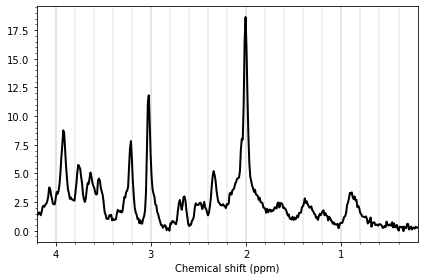

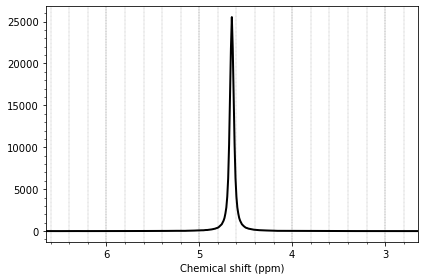

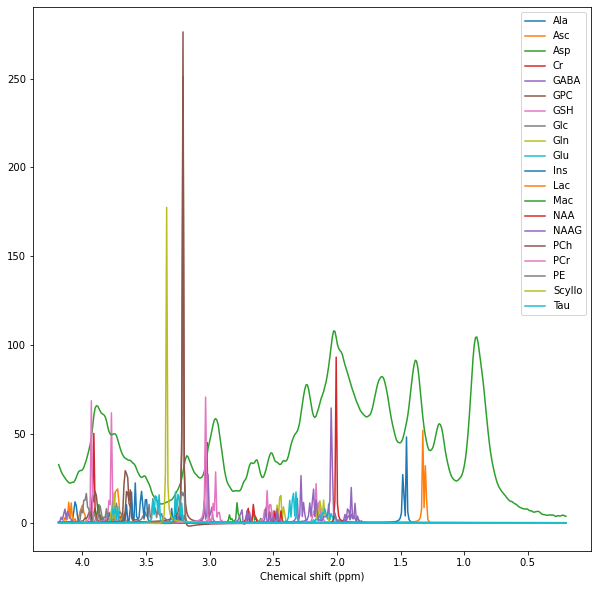

In [16]:
import matplotlib.pyplot as plt

# Create main MRS Object 
mrs = final_data.mrs(basis_file='tutorial3_data/basis/steam_11ms',                     
                     ref_data=final_wref)
mrs.processForFitting()

# Quick plots of the Metab and Water spectra
mrs.plot()
plt.show()
mrs.plot_ref()
plt.show()
plt.figure(figsize=(10,10))
mrs.plot_basis()
plt.show()


Now let's start the actual fitting process:

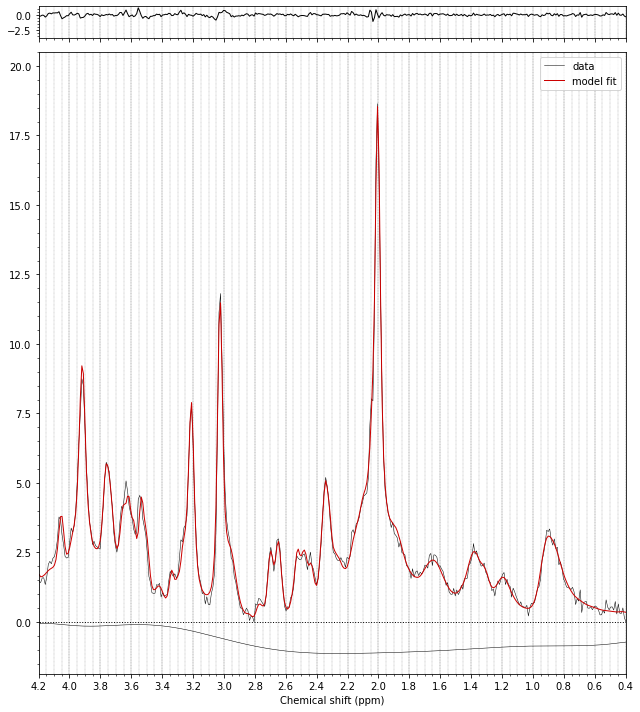

In [23]:
from fsl_mrs.utils import fitting, misc, plotting

# Separate macromolecule from the rest (it will have its own lineshape parameters)
metab_groups = misc.parse_metab_groups(mrs,'Mac')

# Fit with Newton algorithm
Fitargs = {'ppmlim':[0.2,4.2],
           'method':'Newton','baseline_order':10,
           'metab_groups':metab_groups,
           'model':'voigt'}

res = fitting.fit_FSLModel(mrs,**Fitargs)

# Quick sanity-plot of the fit (see further down for interactive plotting)
_ = plotting.plot_fit(mrs,pred=res.pred,baseline=res.baseline)

The fit merely returns ratios of integrals of the fitted basis functions. In order to actually quantify the metabolite concentrations from these ratios, some additional information needs to be taken into account. 

First of all, a water molecule has two protons attached to it, while other metabolites may have any number of protons, which give rise to the individual peaks. Hence, the integral ratios need to be corrected for the number of protons giving rise to a certain resonance peak. 
The echo time and repetition time of the acquisition, together with relaxation times of individual metabolites from literature, allow to calculate how much any individual signal has decayed at the point of acquisition, and hence to correct the ratio for this signal decay. Furthermore, a voxel typically contains a mixture of different tissue types of gray matter (GM), white matter (WM), and cerebrospinal fluid (CSF). In CSF usually no metabolites are found, however, the water concentration in CSF is higher than in GM and WM. Moreover, the metabolite relaxation in GM and WM differs, so different relaxation times need to be considered for the different tissue fractions. 

Luckily, FSL-MRS already integrated all these corrections, so we can easily use the fitting results to calculate the final metabolite concentrations:

In [18]:
import pandas as pd
from fsl_mrs.utils import quantify

combinationList = [['NAA','NAAG'],
                   ['Glu','Gln'],
                   ['GPC','PCh'],
                   ['Cr','PCr'],
                   ['Glc','Tau']]

res.combine(combinationList)

te = final_data.hdr_ext['EchoTime']
tr = final_data.hdr_ext['RepetitionTime']
q_info = quantify.QuantificationInfo(te,
                                     tr,
                                     mrs.names,
                                     mrs.centralFrequency / 1E6)
q_info.set_fractions({'WM':0.45,'GM':0.45,'CSF':0.1})
 
res.calculateConcScaling(mrs,
                         quant_info=q_info,
                         internal_reference=['Cr', 'PCr'])

internal = res.getConc(scaling='internal',function=None).mean().multiply(8)
molarity = res.getConc(scaling='molarity',function=None).mean()
print(pd.concat([internal.rename('/Cr+PCr',inplace=True), molarity.rename('molarity (mM)',inplace=True)], axis=1))

            /Cr+PCr  molarity (mM)
Ala        0.000000       0.000000
Asc        0.123057       0.119426
Asp        1.341783       1.302187
Cr         5.162457       5.010115
GABA       1.624210       1.576280
GPC        1.115097       1.082191
GSH        1.375695       1.335098
Glc        0.000000       0.000000
Gln        1.322239       1.283220
Glu        8.514278       8.263025
Ins        6.235218       6.051219
Lac        0.626902       0.608402
Mac        0.597456       0.579825
NAA       11.118365      10.790267
NAAG       1.599534       1.552333
PCh        0.378935       0.367752
PCr        2.837543       2.753808
PE         1.361645       1.321464
Scyllo     0.558432       0.541953
Tau        1.577474       1.530924
Cr+PCr     8.000000       7.763923
NAA+NAAG  12.717899      12.342600
Glu+Gln    9.836516       9.546245
GPC+PCh    1.494031       1.449943
Glc+Tau    1.577474       1.530924


Plot fit results along with concentration table and CRLBs

In [19]:
fig = plotting.plotly_fit(mrs,res)
fig.show()


/home/fillme01/.conda/envs/FSL-test/lib/python3.9/site-packages/fsl_mrs/utils/results.py:627: RuntimeWarning:

divide by zero encountered in true_divide



# Tasks:

1) How does the frequency and phase alignment influence the quantification results? 

2) How do different fitting parameter influence the quantification? What happens if: 

    2a) You exclude an individual basis function?
    
    2b) You change the polynomial baseline order?
    
    2c) You change the model lineshape to a lorenzian?
    
How are the concentrations and CRLBs affected?

In [ ]:
# Process the data without phase and frequency alignment:
# Averaging of transients:
supp_data = proc.average(supp_data, 'DIM_DYN')
quant_data = proc.average(quant_data, 'DIM_DYN')
# Eddy current correction:
supp_data = proc.ecc(supp_data, ecc_data)
quant_data = proc.ecc(quant_data, quant_data)
# Remove the first data point of the FID:
supp_data = proc.truncate_or_pad(supp_data, -1, 'first')
quant_data = proc.truncate_or_pad(quant_data, -1, 'first')
# HLSVD water peak removal
limits = [-0.15,0.15]
limunits = 'ppm'
supp_data = proc.remove_peaks(supp_data, limits, limit_units=limunits)
# shift to reference frequency
supp_data = proc.shift_to_reference(supp_data, 3.027, (2.9, 3.1))
# final phase correction
final_data_unaligned = proc.phase_correct(supp_data, (2.9, 3.1))
final_wref_unaligned = proc.phase_correct(quant_data, (4.55, 4.7), hlsvd=False)

In [ ]:
# Perform fitting procedure with different options
# Create main MRS Object for unaligned data
mrs_unaligned = final_data_unaligned.mrs(basis_file='tutorial3_data/basis/steam_11ms',                     
                     ref_data=final_wref_unaligned)
mrs_unaligned.processForFitting()



In [ ]:
# Here you can change the parameters for the fitting to answer the above questions
# Separate macromolecule from the rest (it will have its own lineshape parameters)
metab_groups = misc.parse_metab_groups(mrs,'Mac')

mrs.ignore = ([])
# here you can insert a metabolite list, whose basis functions will be ignored during the fit. 
# To find the names, check the plot of the basis functions above.
#mrs.ignore = (['GABA'])
print(mrs.ignore)

# Here you can change the parameters baseline_order and model for the fitting
Fitargs = {'ppmlim':[0.2,4.2],
           'method':'Newton','baseline_order':10,
           'metab_groups':metab_groups,
           'model':'voigt'}

res = fitting.fit_FSLModel(mrs,**Fitargs)

# Quick sanity-plot of the fit (see further down for interactive plotting)
_ = plotting.plot_fit(mrs,pred=res.pred,baseline=res.baseline)

## Part 2: Analysis of Cohort Data

The second part of this notebook demonstrates a statistical analysis of data while using measurement uncertainties as weights. 

The example data set represents a cohort that includes three different patient groups. In clinical studies, the first group is usually a healthy control group. The second and third group usually either represent different stages of a disease or two different diseases, for which it is important to find biomarkers to distinguish them reliably.

### Loading and Sorting the data

First let's load the data from the provided Excel sheet: 

In [30]:
import pandas as pd
table = pd.read_excel('tutorial3_data/Metabolite_cohort_data.xlsx')
print(table)

      Patient ID  Group        NAA      CRLB
0   Math+TES-001      1  12.630477  0.237121
1   Math+TES-002      3   9.747942  0.410651
2   Math+TES-003      1  11.500331  0.275336
3   Math+TES-004      2  12.937575  0.782318
4   Math+TES-005      1   9.683457  0.310009
..           ...    ...        ...       ...
85  Math+TES-086      3  11.600245  0.483263
86  Math+TES-087      2  11.542238  0.626577
87  Math+TES-088      1   7.847223  0.513957
88  Math+TES-089      3   6.930442  0.507629
89  Math+TES-090      1  10.925887  0.297269

[90 rows x 4 columns]


Often study results are sorted for the pseudonyms of the study participants, and they need to be sorted according to the question at hand. Here we want to compare the different patient groups, so we'll sort the values into arrays with the groups as columns. We'll create one array for the metabolite concentration that we will investigate, and one array for the respective CRLBs:

In [31]:
import numpy as np

# sort table with respect to group
table_sorted = table.sort_values(by=['Group', 'Patient ID'])

group_array = table_sorted[['Group']].to_numpy()
no_groups = np.shape(np.unique(group_array))[0]
no_volunteers = np.shape(group_array)[0]
idx_groups = np.zeros(no_groups)

# figure out how large the different groups are
sLargestGroup = 0
k = 0
while k < no_groups:
    idx_groups[k] = np.where(group_array==(k+1))[0][0]
    if idx_groups[k]-idx_groups[k-1] > sLargestGroup and k >=1:
        sLargestGroup = int(idx_groups[k]-idx_groups[k-1])
    k = k+1

table_sorted = table_sorted[['NAA', 'CRLB']].to_numpy()    
    
# allocate arrays according to the size needed
conc_array = np.zeros((sLargestGroup, no_groups))
CRLB_array = np.zeros((sLargestGroup, no_groups))

# fill in the arrays with the values of interest
k = 0
while k < no_groups:
    if k+1 == no_groups:
        conc_array[:,k] = table_sorted[int(idx_groups[k]):int(no_volunteers), 0]
        CRLB_array[:,k] = table_sorted[int(idx_groups[k]):int(no_volunteers), 1]
        k = k+1
    else:
        conc_array[:,k] = table_sorted[int(idx_groups[k]):int(idx_groups[k+1]), 0]
        CRLB_array[:,k] = table_sorted[int(idx_groups[k]):int(idx_groups[k+1]), 1]
        k = k+1
        
print(conc_array)
print(CRLB_array)


[[12.63047696 12.93757477  9.74794151]
 [11.50033109 11.5957383   9.71698072]
 [ 9.68345685 10.72328674  8.11385647]
 [11.22699547 12.20963999 11.92923909]
 [ 9.18455773  7.19037117  9.51024329]
 [ 8.54295951 10.5955592   8.28948666]
 [12.36220409 12.47907661 12.62791011]
 [10.79008474 11.01619988  9.31798078]
 [10.69663785 10.88515931  8.55303904]
 [12.33891635  8.10141104  9.17311744]
 [11.80079229 10.71912842  8.00935489]
 [11.385342   12.32439813  7.43773057]
 [12.91542709 11.77069138 15.09459935]
 [12.37064208  8.93253989 13.26654495]
 [11.19759754  9.24615446 10.43582383]
 [ 8.61638613 12.44448904  7.15005145]
 [ 9.68235881  5.59578587  7.97251714]
 [12.81657318 12.91772507  9.41927836]
 [ 8.04988834 11.56639651 11.45197373]
 [10.74841471 13.09013989  6.99279072]
 [ 7.4769598   5.96242171  4.89727897]
 [12.52484662  8.4329205   6.74689569]
 [12.25491771  8.15045242 10.49037275]
 [10.79197554 12.76224609 10.61184257]
 [ 9.66957674  5.94853839 10.73852678]
 [ 7.56331733 12.87475895

First, let's have a look at the data:

{'whiskers': [<matplotlib.lines.Line2D at 0x7f67be753cd0>,
 'caps': [<matplotlib.lines.Line2D at 0x7f67be7493d0>,
 'boxes': [<matplotlib.lines.Line2D at 0x7f67be753970>,
 'medians': [<matplotlib.lines.Line2D at 0x7f67be749a90>,
 'fliers': [<matplotlib.lines.Line2D at 0x7f67be749df0>,
 'means': []}

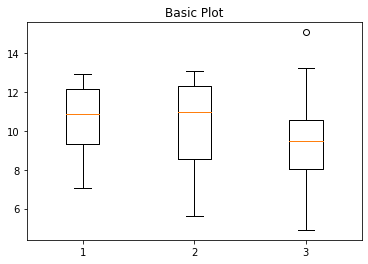

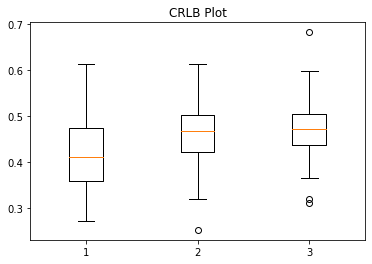

In [44]:
import numpy as np
import matplotlib.pyplot as plt

fig1, ax1 = plt.subplots()
ax1.set_title('Basic Plot')
ax1.boxplot(conc_array)
fig2, ax1 = plt.subplots()
ax1.set_title('CRLB Plot')
ax1.boxplot(CRLB_array)

### Statistical Testing for group differences: Welch's t-test

First let's do a rather standard statistical test, the Welch's t-test. A Welch's t-test assumes that variances between different groups are different, which in MRS often is a valid assumption, as patients have a harder time to lie still throughout the examination, or other factors come into play, that might have a detrimental effect on data quality.

In [15]:
import statsmodels.stats.weightstats as sm

# Test for differences between groups 1 and 2
(t_12, p_12, df_12) = sm.ttest_ind(conc_array[:,0], conc_array[:,1], alternative='two-sided', usevar='unequal', weights=(None, None), value=0)
print("Groups 1 and 2: " + "T = " + str(t_12) + "; p = " + str(p_12) + "; df = " + str(df_12))

# Test for differences between groups 1 and 3
(t_13, p_13, df_13) = sm.ttest_ind(conc_array[:,0], conc_array[:,2], alternative='two-sided', usevar='unequal', weights=(None, None), value=0)
print("Groups 1 and 3: " + "T = " + str(t_13) + "; p = " + str(p_13) + "; df = " + str(df_13))

# Test for differences between groups 2 and 3
(t_23, p_23, df_23) = sm.ttest_ind(conc_array[:,1], conc_array[:,2], alternative='two-sided', usevar='unequal', weights=(None, None), value=0)
print("Groups 2 and 3: " + "T = " + str(t_23) + "; p = " + str(p_23) + "; df = " + str(df_23))


Groups 1 and 2: T = 0.19911333008399582; p = 0.8429121394062341; df = 54.717973027867046
Groups 1 and 3: T = 2.061243689805394; p = 0.043924589072765176; df = 56.11517987114038
Groups 2 and 3: T = 1.6486158878765382; p = 0.10465576565419542; df = 57.75944567410769


Now let's include the CRLBs as weights and see how the statistical test results are affected. 

Note: If degrees of freedom correction is used, as is the case here, then weights should add up to the number of observations. A common t-test also assumes that the sum of weights corresponds to the sample size. If this would not be the case, the resulting p-values would correspond to a different sample size, and hence being inaccurate for accepting or rejecting the Null-hypothesis.

# Task: How does the weighting affect the statistical test results?

In [33]:
corr_factor_12 = 60/(sum(1/CRLB_array[:,0])+sum(1/CRLB_array[:,1]))
corr_factor_13 = 60/(sum(1/CRLB_array[:,0])+sum(1/CRLB_array[:,2]))
corr_factor_23 = 60/(sum(1/CRLB_array[:,1])+sum(1/CRLB_array[:,2]))

# Test for differences between groups 1 and 2
(tw_12, pw_12, dfw_12) = sm.ttest_ind(conc_array[:,0], conc_array[:,1], alternative='two-sided', usevar='unequal', weights=((1/CRLB_array[:,0])*corr_factor_12, (1/CRLB_array[:,1])*corr_factor_12), value=0)
print("Groups 1 and 2, weighted: " + "T = " + str(tw_12) + "; p = " + str(pw_12) + "; df = " + str(dfw_12))

# Test for differences between groups 1 and 3
(tw_13, pw_13, dfw_13) = sm.ttest_ind(conc_array[:,0], conc_array[:,2], alternative='two-sided', usevar='unequal', weights=((1/CRLB_array[:,0])*corr_factor_13, (1/CRLB_array[:,2])*corr_factor_13), value=0)
print("Groups 1 and 3, weighted: " + "T = " + str(tw_13) + "; p = " + str(pw_13) + "; df = " + str(dfw_13))

# Test for differences between groups 2 and 3
(tw_23, pw_23, dfw_23) = sm.ttest_ind(conc_array[:,1], conc_array[:,2], alternative='two-sided', usevar='unequal', weights=((1/CRLB_array[:,1])*corr_factor_23, (1/CRLB_array[:,2])*corr_factor_23), value=0)
print("Groups 2 and 3, weighted: " + "T = " + str(tw_23) + "; p = " + str(pw_23) + "; df = " + str(dfw_23))

Groups 1 and 2, weighted: T = 1.2170469403682393; p = 0.23418614812631078; df = 26.82381291173388
Groups 1 and 3, weighted: T = 2.91541335730996; p = 0.005549642693440912; df = 44.390590335311664
Groups 2 and 3, weighted: T = 1.182856728706379; p = 0.24317109803454856; df = 44.33061877249578
